# run 6341 - graph of several double-scape or Tl photo-peaks events



In [1]:
import time
print("Last updated on ", time.asctime())

Last updated on  Sun Dec  9 23:47:45 2018


In [2]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [3]:
import os
import time
import datetime

import tables            as tb
import numpy             as np
import matplotlib.pyplot as plt
import matplotlib.dates  as md
import collections       as collections
import pandas            as pd

from   scipy import optimize
import invisible_cities.core.fit_functions as fitf
from  invisible_cities.core .core_functions import in_range

import csth.dev.cepeak_ana_plot as caplot

import krcal.utils.plt_functions          as krplot
import krcal.utils.hst_extend_functions   as hst

In [4]:
# Plotting style
default_cmap = "jet"
figure_size  = 14, 8
font_size    = 14

plt.rcParams["figure.figsize"] =   figure_size
plt.rcParams[  "font.size"   ] =   font_size

## Events

In [5]:
run_number = 6341
tag = "trigger2_v0.9.9_20180921_krbg1300"
   
def get_input_files(locations, run_number = run_number, tag = tag):
    locations  = ["{:04}".format(i) for i in locations]
    input_filenames  = [f"$IC_DATA/{run_number}/pmaps/trigger2/pmaps_{location}_{run_number}_{tag}.h5" for location in locations]
    input_files     = [os.path.expandvars(ifile) for ifile in input_filenames]
    return input_files

correction_filename    = f"$IC_DATA/maps/kr_corrections_run{run_number}.h5"
correction_file        = os.path.expandvars(correction_filename)

In [6]:
run_numbers = [6341,]
ftrail = '6q0min'
input_filenames = [f"$IC_DATA/{run_number}/cepks/cepks_{run_number}_0000_11999_{ftrail}.h5" for run_number in run_numbers]
input_files     = [os.path.expandvars(ifile) for ifile in input_filenames]

In [7]:
def esum_from_hdf(filename, clear = True):
    print(filename)
    h = pd.HDFStore(filename)
    esum = h['esum']
    print('total events :', len(esum))
    esum.dropna()
    sel_base = (esum.nslices > 0) & (esum.nhits > 0) & (esum.zmax < 650.) & (esum.s1e >0)
    esum = esum[sel_base]
    print('clean events :', len(esum) )
    #esum0 = esum[sel_base]
    #h.close()
    return esum

In [8]:
esums = [esum_from_hdf(ifile) for ifile in input_files]

/Users/hernando/investigacion/NEXT/data/runIV//6341/cepks/cepks_6341_0000_11999_6q0min.h5
total events : 203104
clean events : 198732


In [9]:
esum = esums[0]

In [10]:
def ana_events(esum, xsel, erange = None):
    events = esum.event[xsel]   .values
    locats = esum.location[xsel].values
    ifiles = get_input_files(locats)
    erange = (0, len(events)) if erange is None else erange
    
    for iloc in range(*erange):
        evt, ifile = events[iloc], ifiles[iloc]
        epk, cepk = caplot.cepeak(evt, ifile, correction_file, run_number, q0min = 6.)
        caplot.graph_slices(cepk)
        caplot.graph_event(cepk)
        

## Energy regions

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/scipy/optimize/optimize.py:1927: RuntimeWarning: invalid value encountered in double_scalars
  tmp2 = (x - v) * (fx - fw)
/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/scipy/optimize/optimize.py:1928: RuntimeWarning: invalid value encountered in double_scalars
  p = (x - v) * tmp2 - (x - w) * tmp1


Optimization terminated successfully.
         Current function value: 110873.774261
         Iterations: 19
         Function evaluations: 2527
Optimization terminated successfully.
         Current function value: 4054.446311
         Iterations: 12
         Function evaluations: 1437


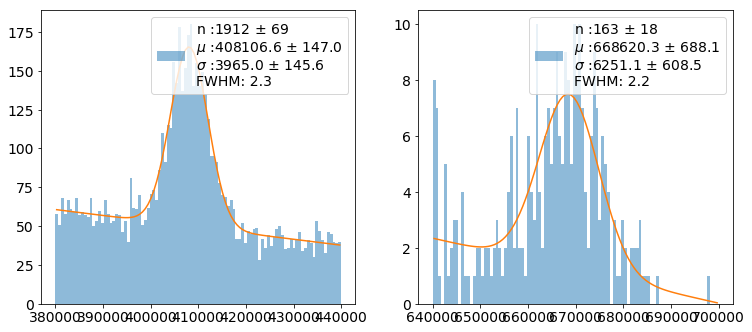

In [11]:
c = hst.Canvas(1, 2)
c(1)
dsres, dscov = caplot.canvas_efit(esum.e, (380e3, 440e3), 100);
c(2)
tlres, tlcov = caplot.canvas_efit(esum.e, (640e3, 700e3), 100);

## Photopeak 

In [19]:
mu, sig, nsig  = tlres.x[3], tlres.x[4], 0.5
print(mu, sig)

668620.3022434762 6251.131414680571


In [20]:
esel = in_range(esum.e, mu - nsig*sig, mu + nsig*sig)
print('nsel ', np.sum(esel))

nsel  81


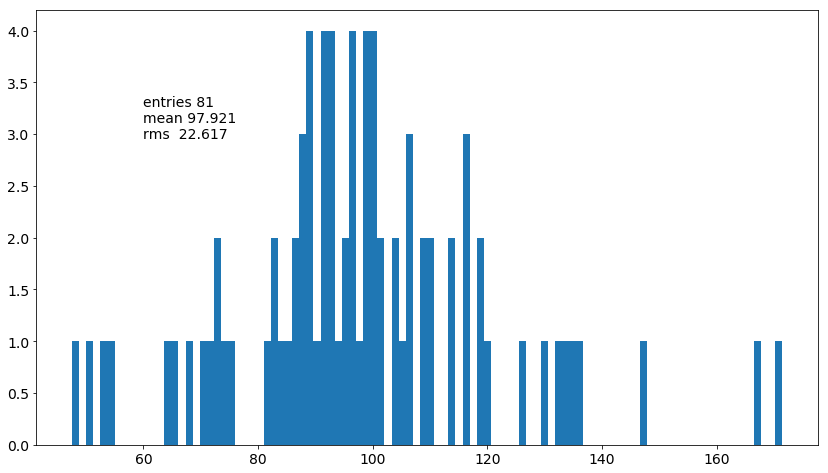

In [21]:
hst.hist(esum.zsize[esel], 100);

### PP long tracks

18
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0012_6341_trigger2_v0.9.9_20180921_krbg1300.h5


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0387_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_3894_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_4584_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_4939_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_5268_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_5410_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_8465_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigge

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_9819_6341_trigger2_v0.9.9_20180921_krbg1300.h5


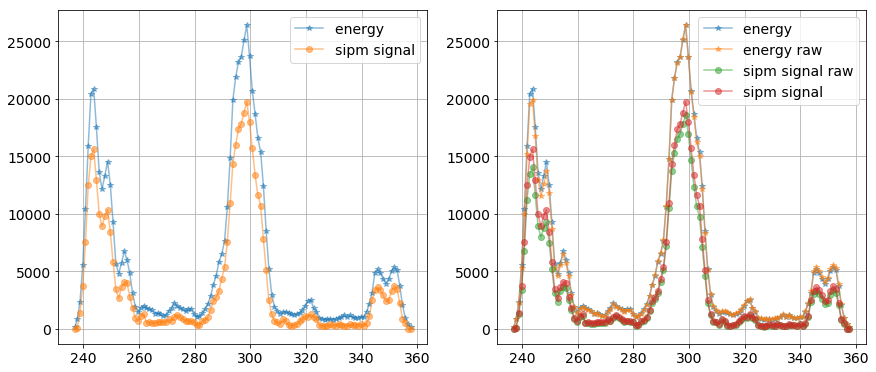

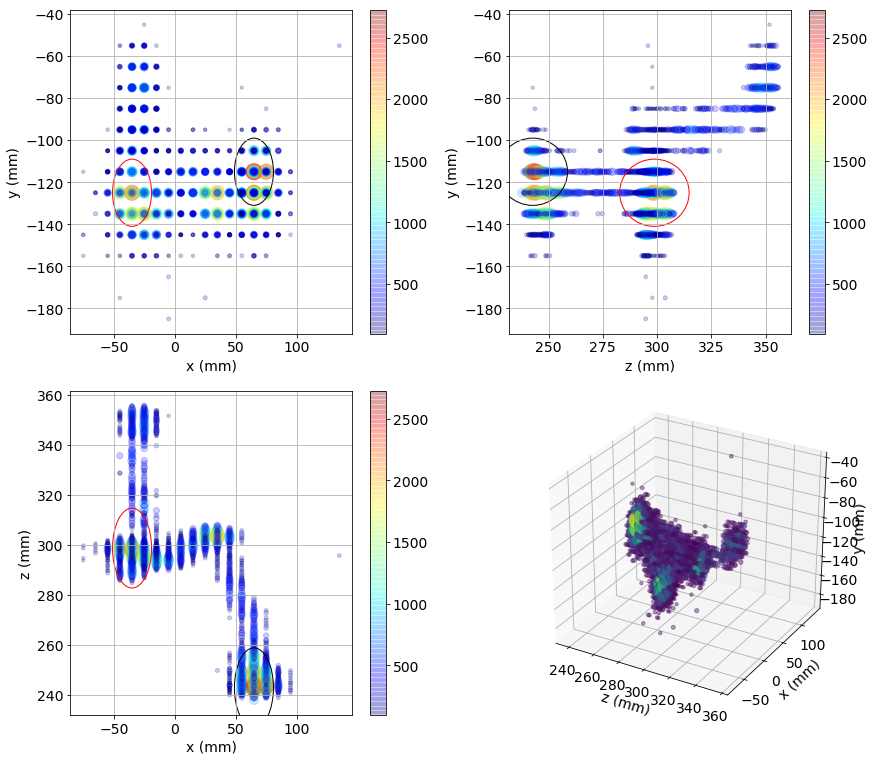

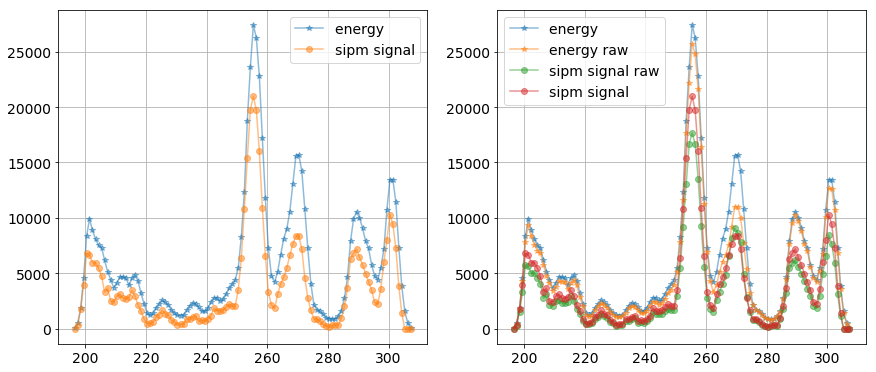

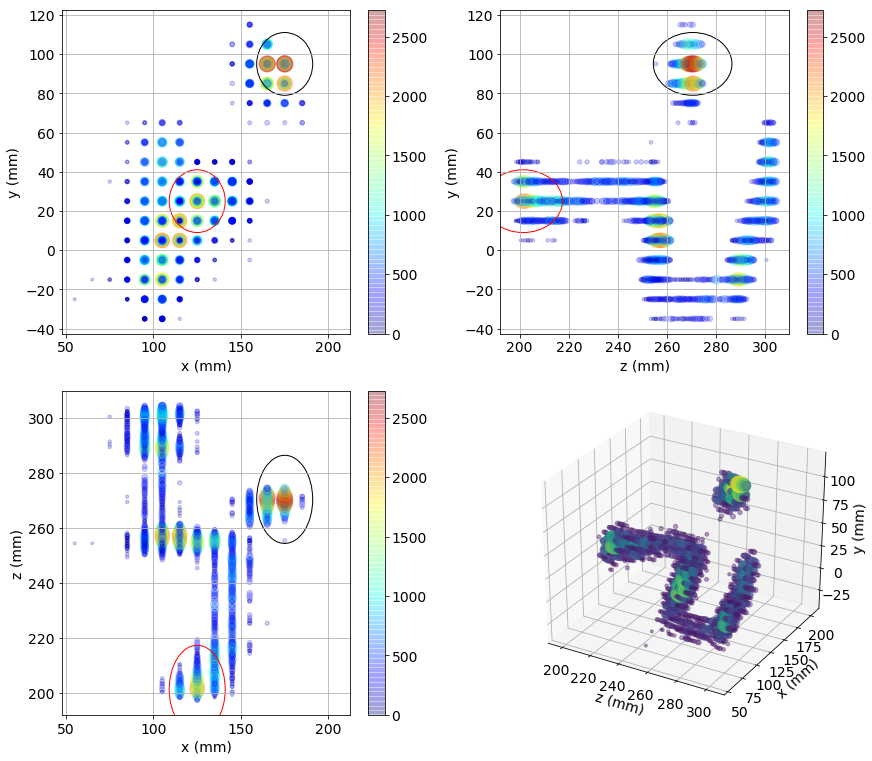

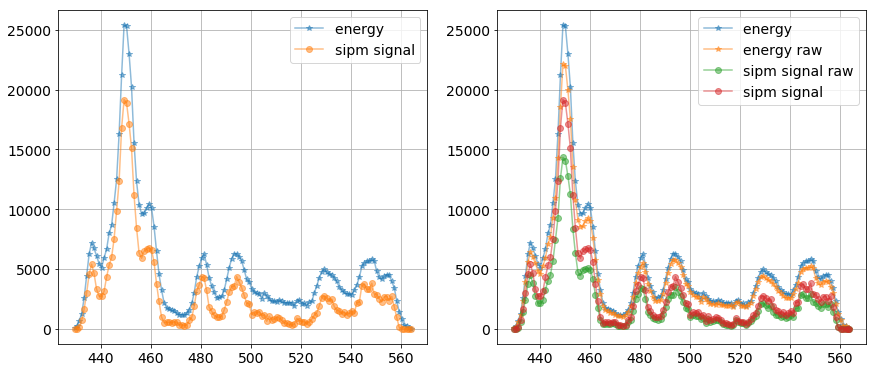

...

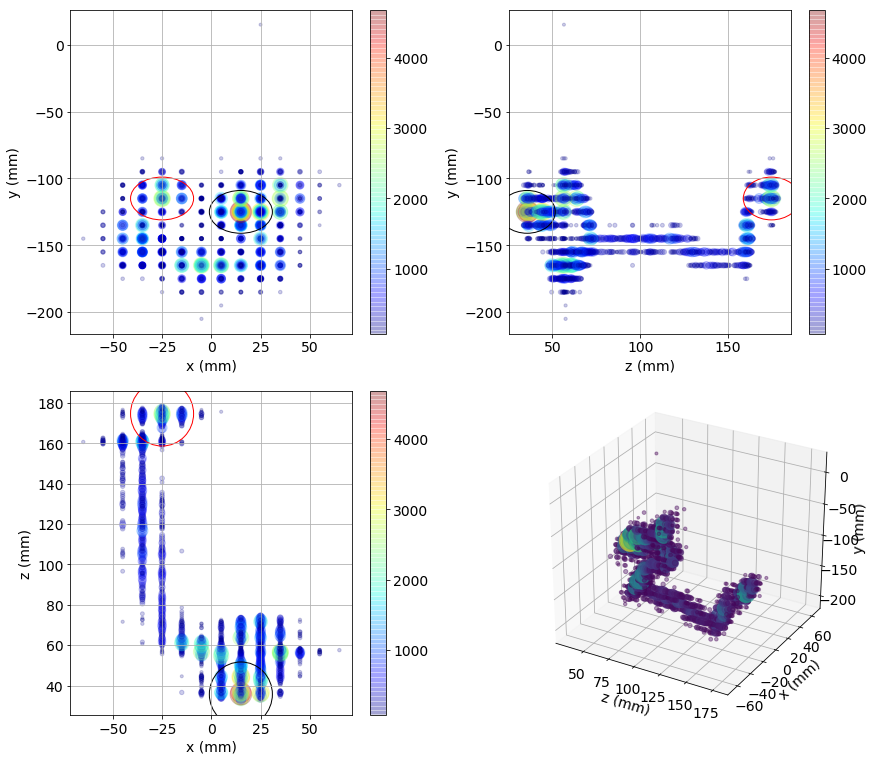

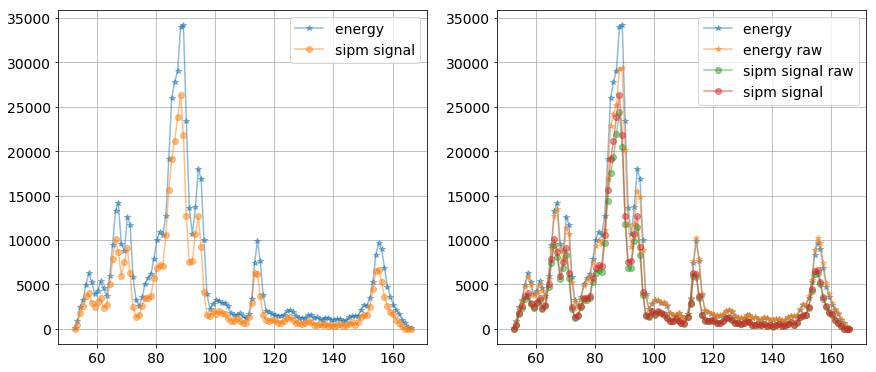

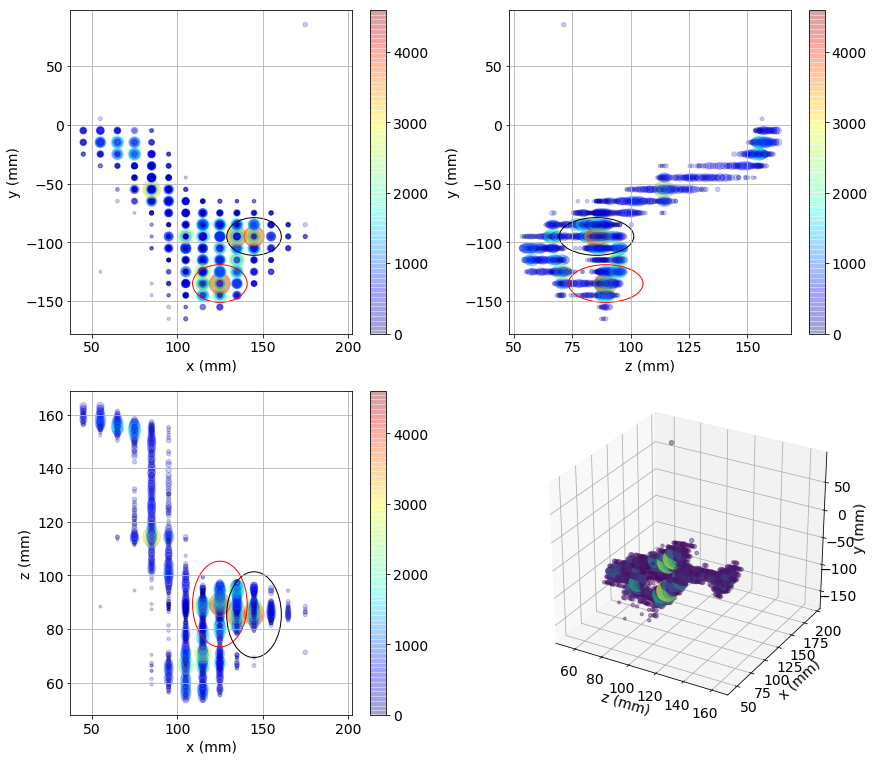

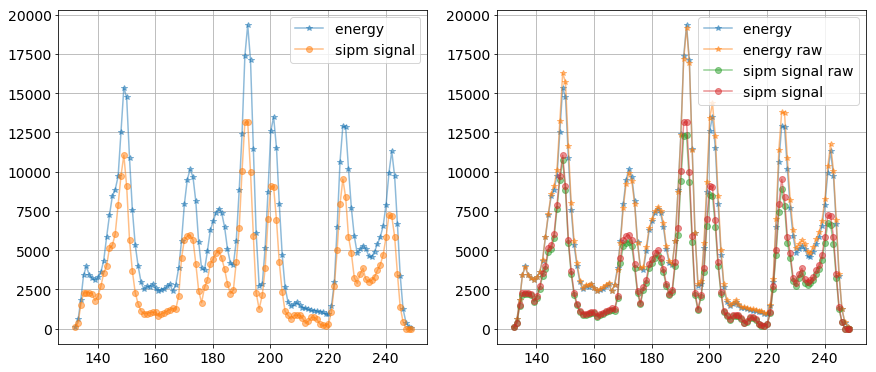

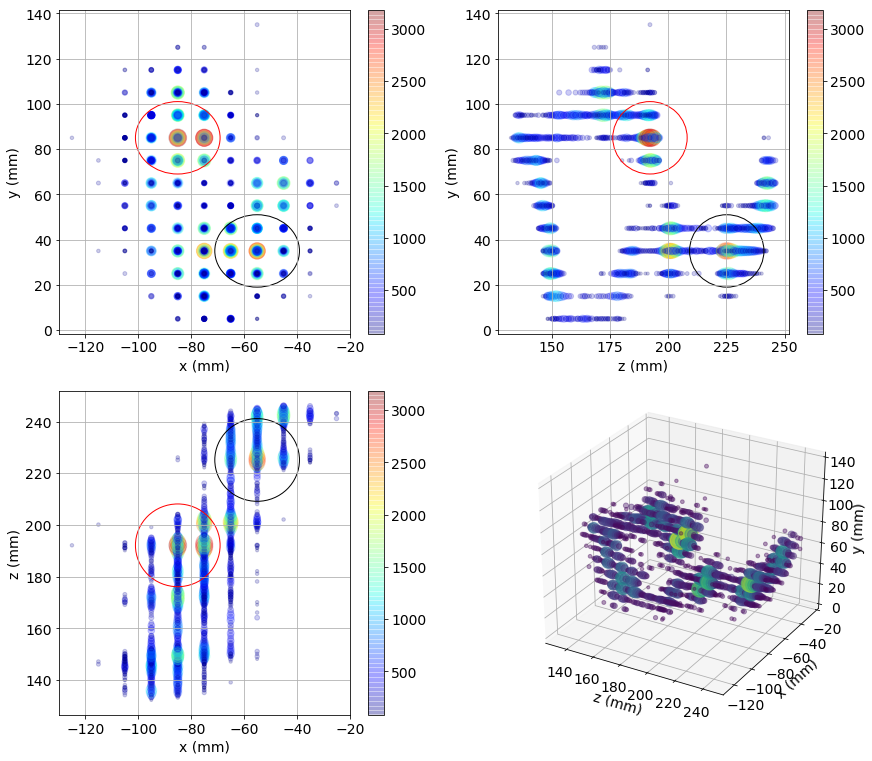

In [22]:
xsel = esel & (in_range(esum.zsize, 110, 200))
print(np.sum(xsel))
ana_events(esum, xsel, (0, 12))

31
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_5730_6341_trigger2_v0.9.9_20180921_krbg1300.h5


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_6711_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_7277_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_8224_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_8282_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_8465_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_8596_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_8709_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigge

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_9819_6341_trigger2_v0.9.9_20180921_krbg1300.h5


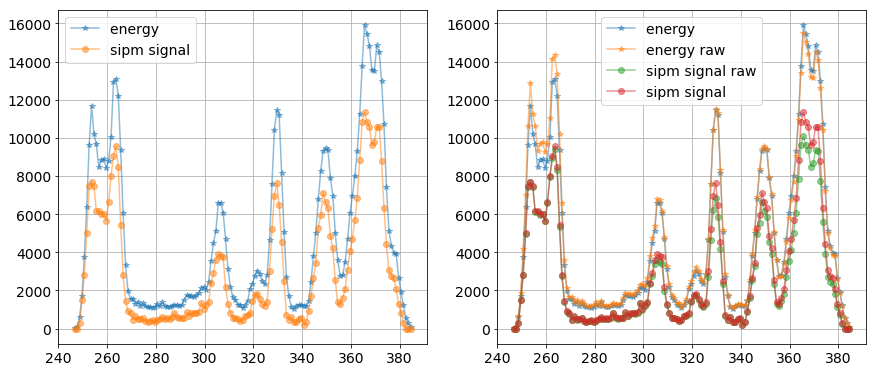

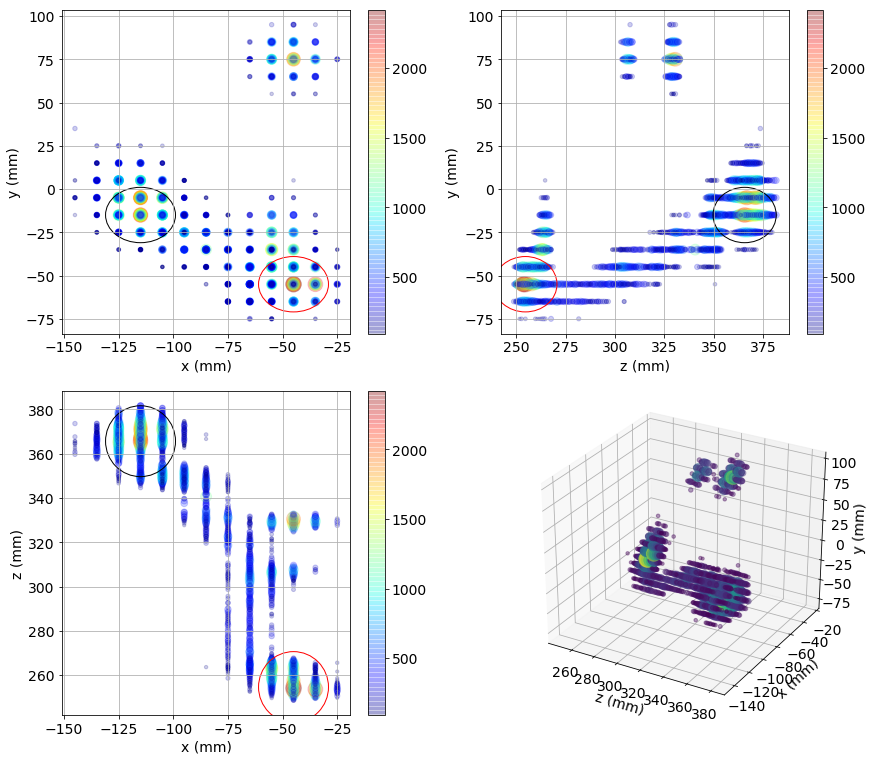

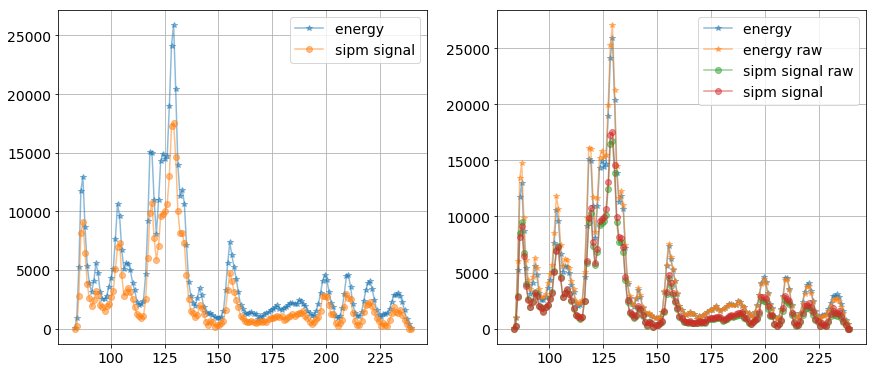

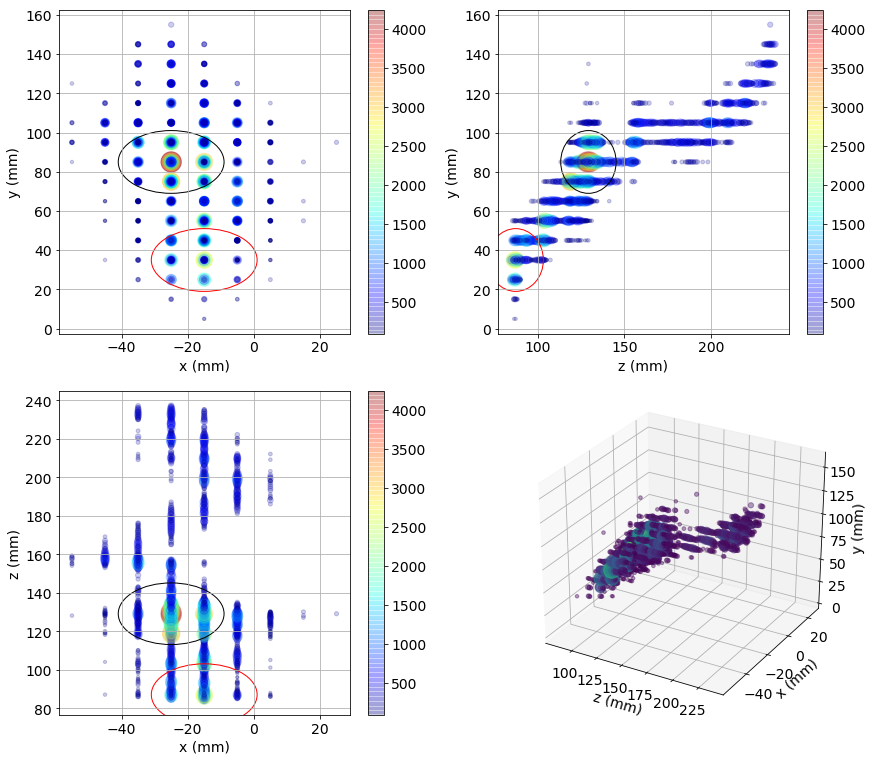

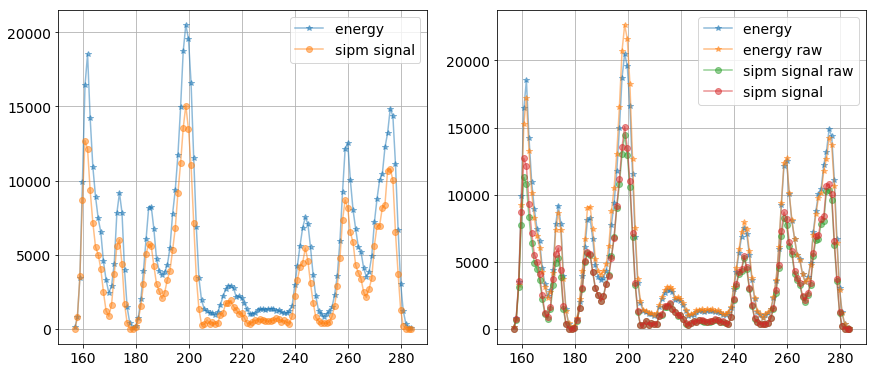

...

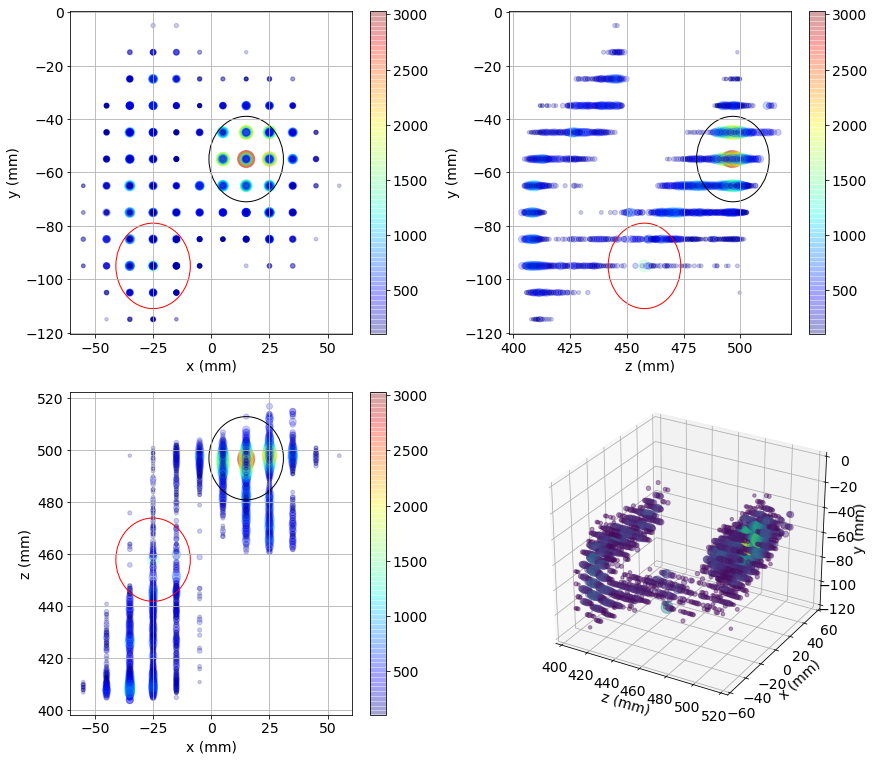

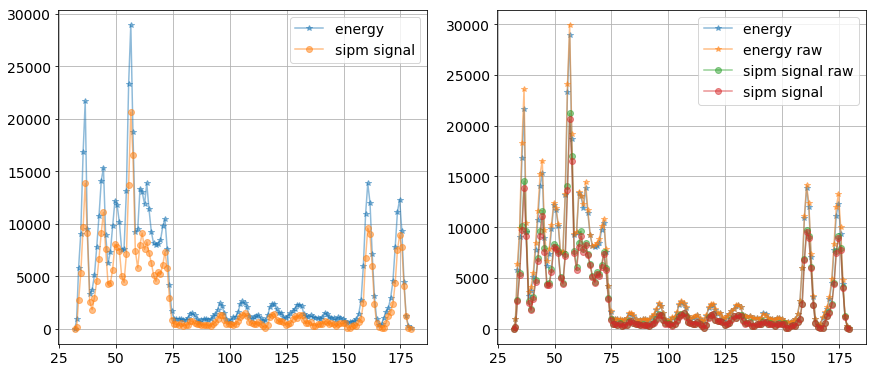

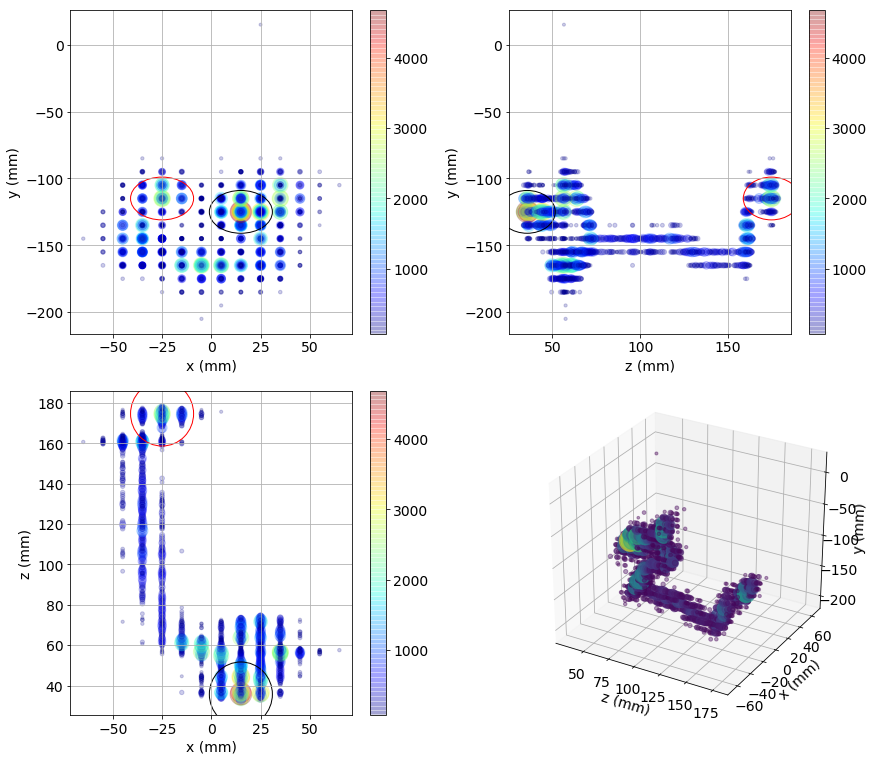

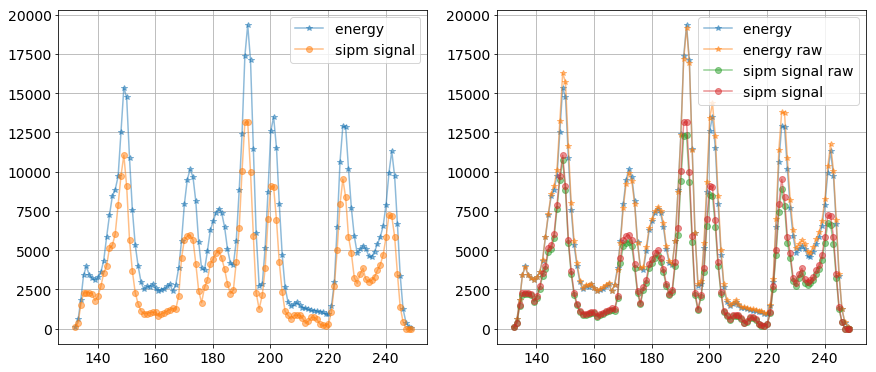

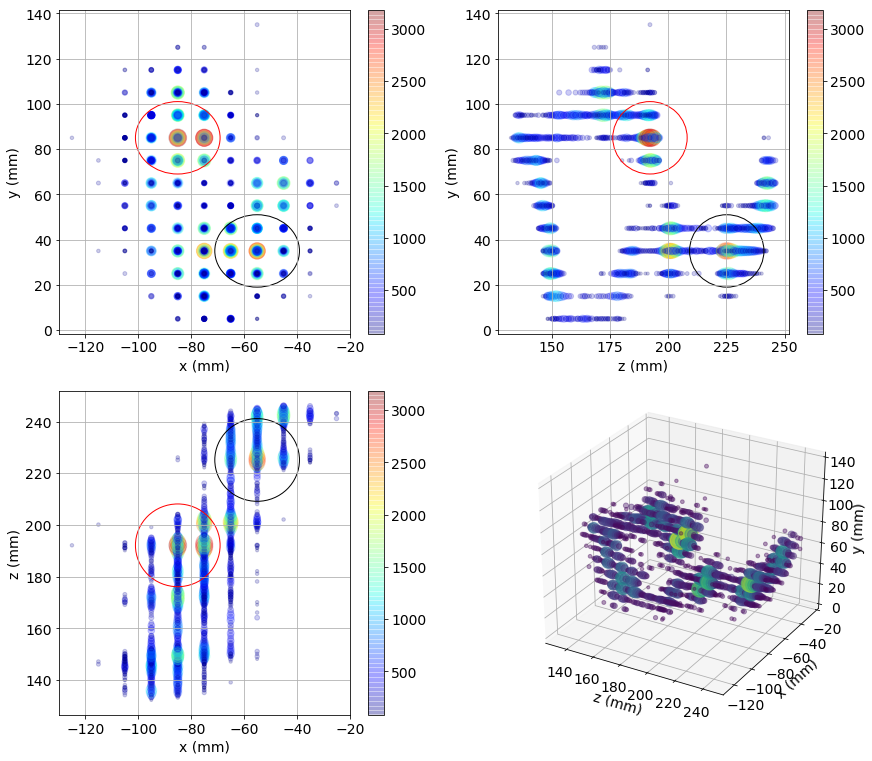

In [17]:
xsel = esel & (in_range(esum.zsize, 115, 200))
print(np.sum(xsel))
ana_events(esum, xsel, (12, 24))

### PP short tracks

31
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0480_6341_trigger2_v0.9.9_20180921_krbg1300.h5


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0548_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0769_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_1579_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_1945_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_2467_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_2495_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_2534_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigge

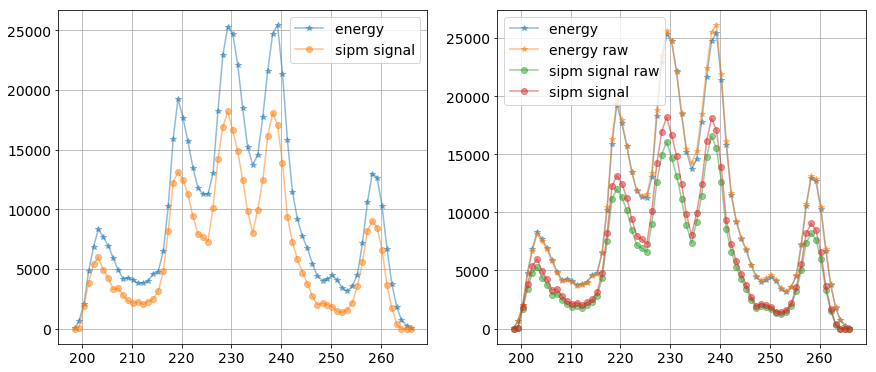

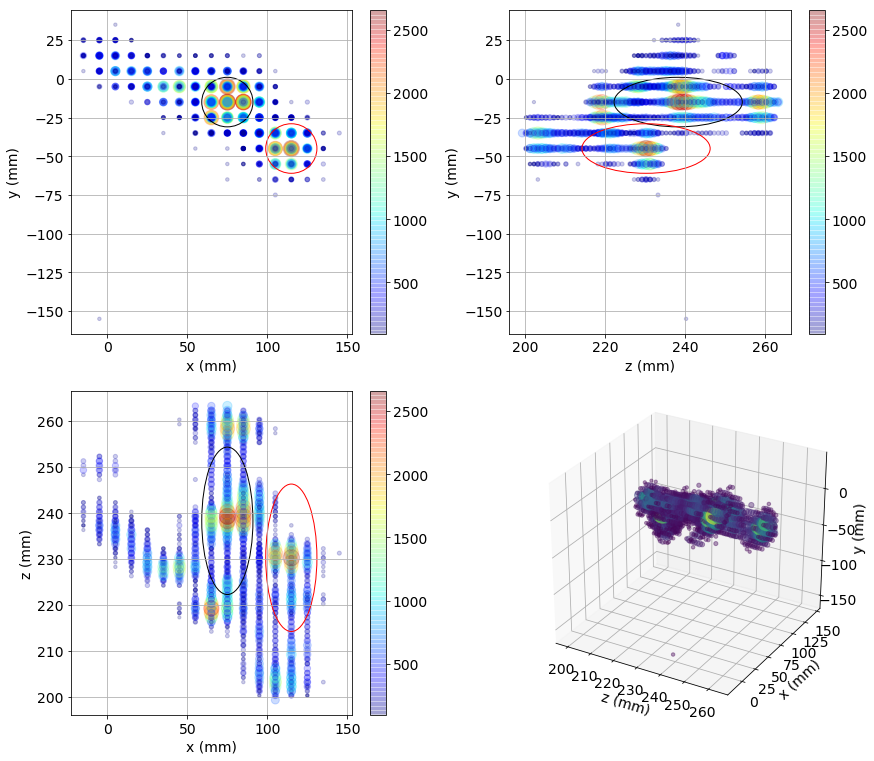

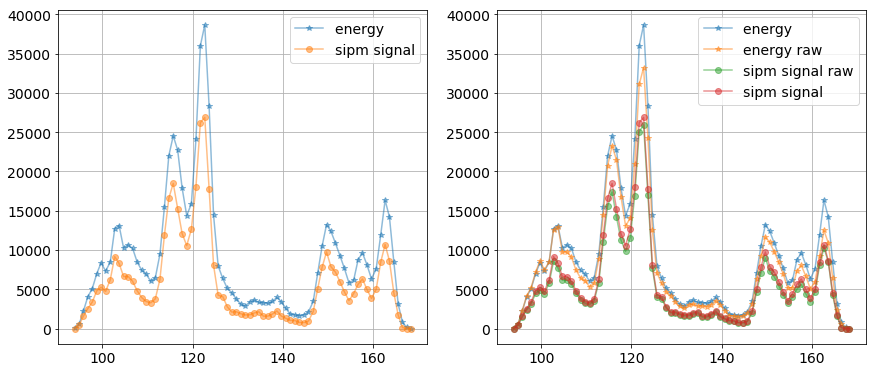

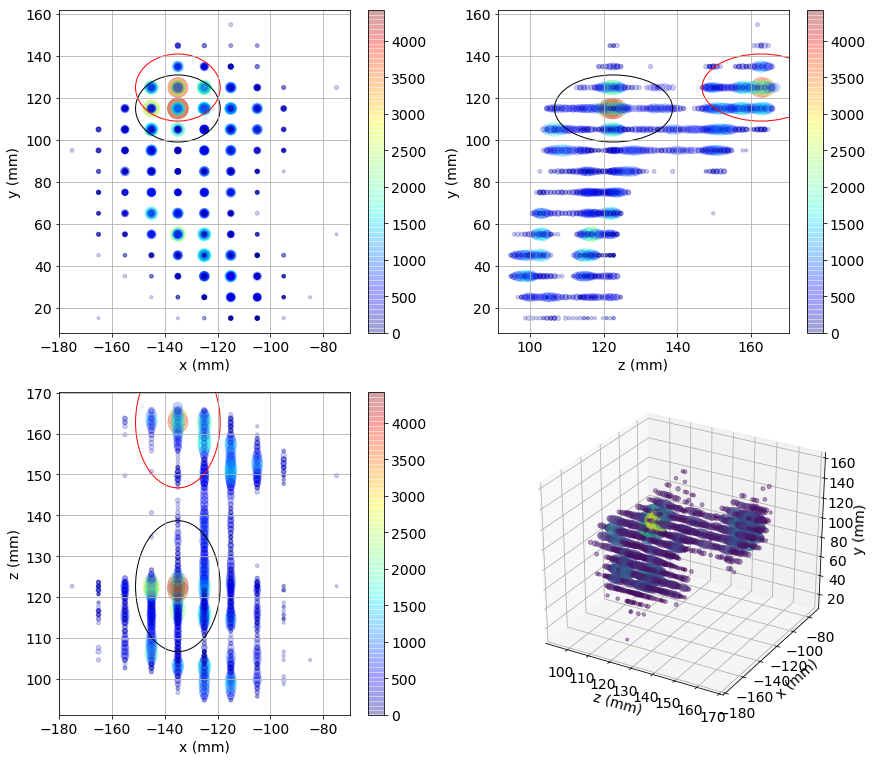

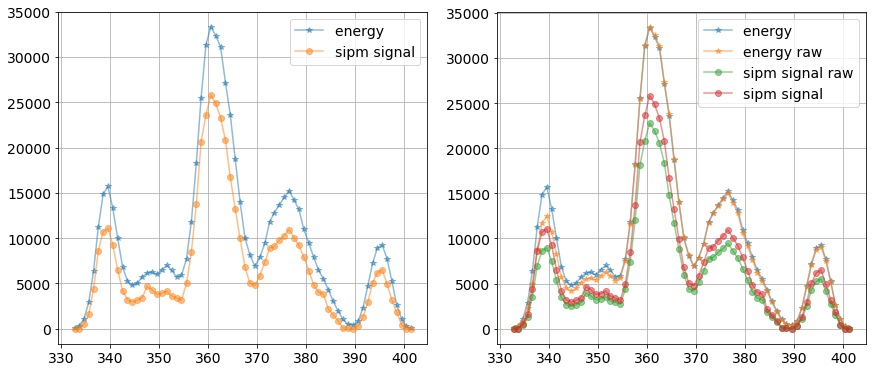

...

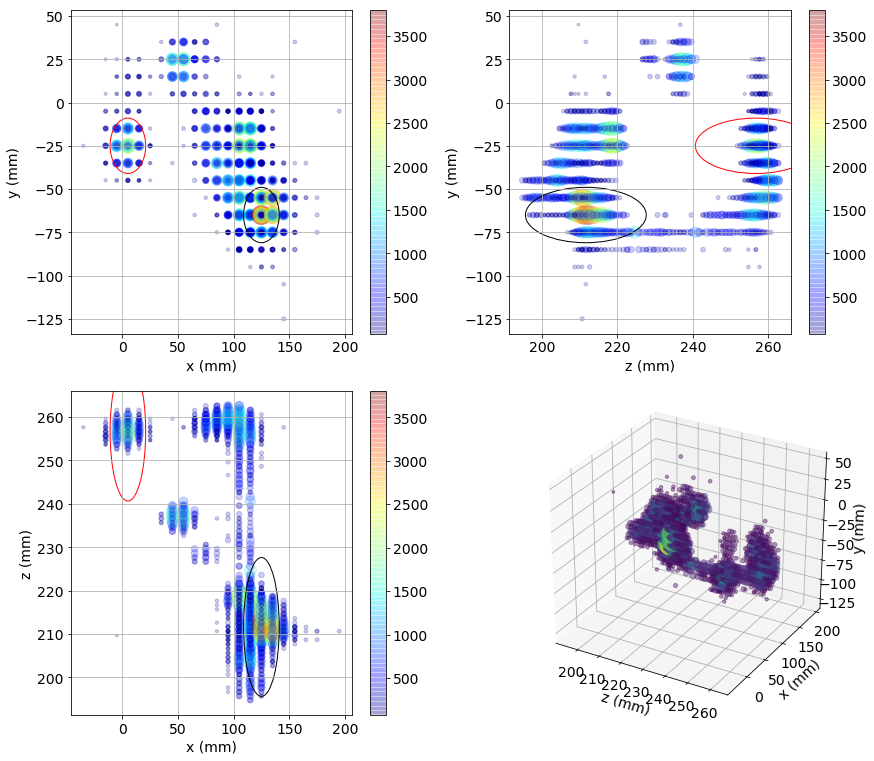

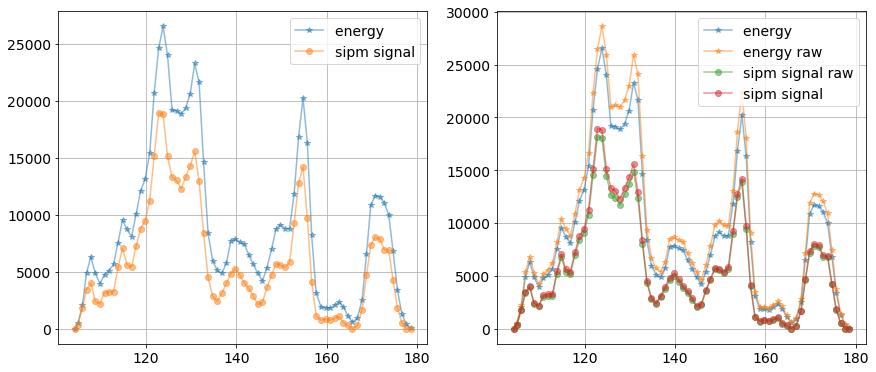

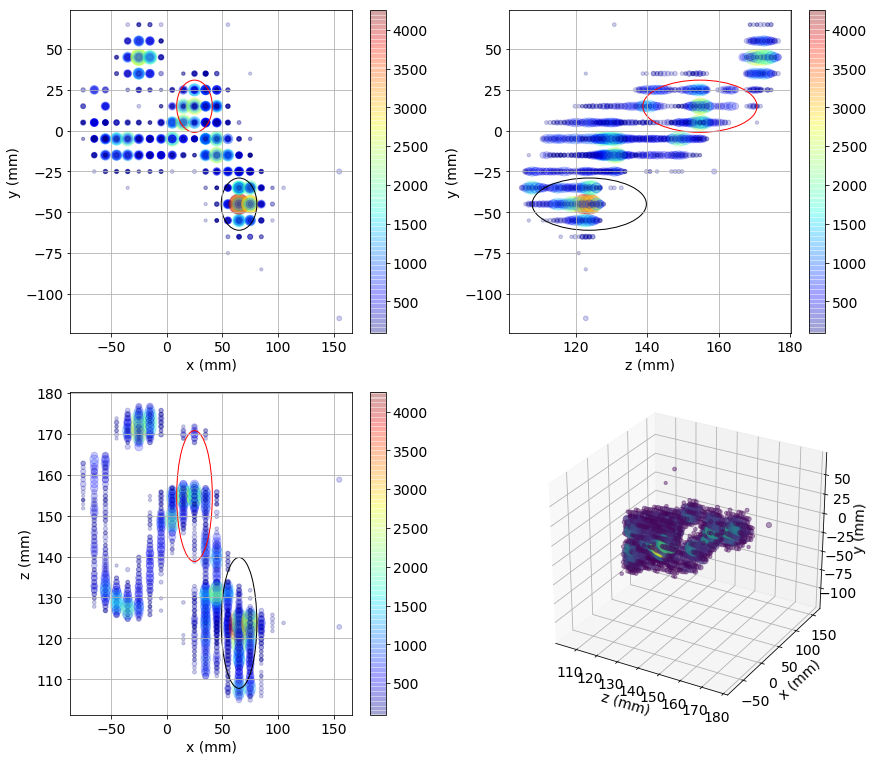

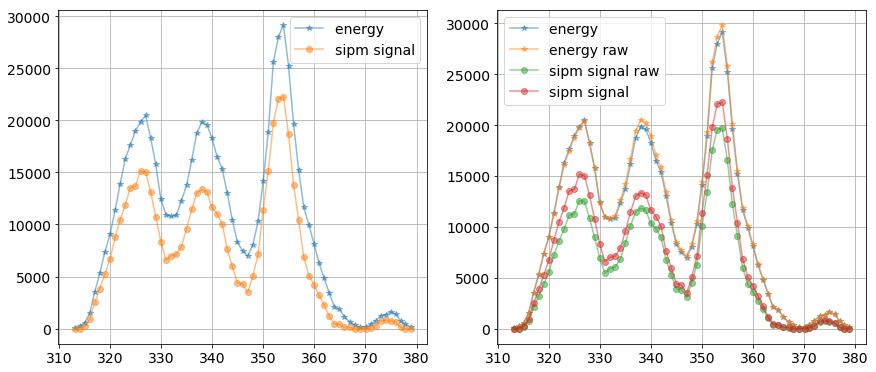

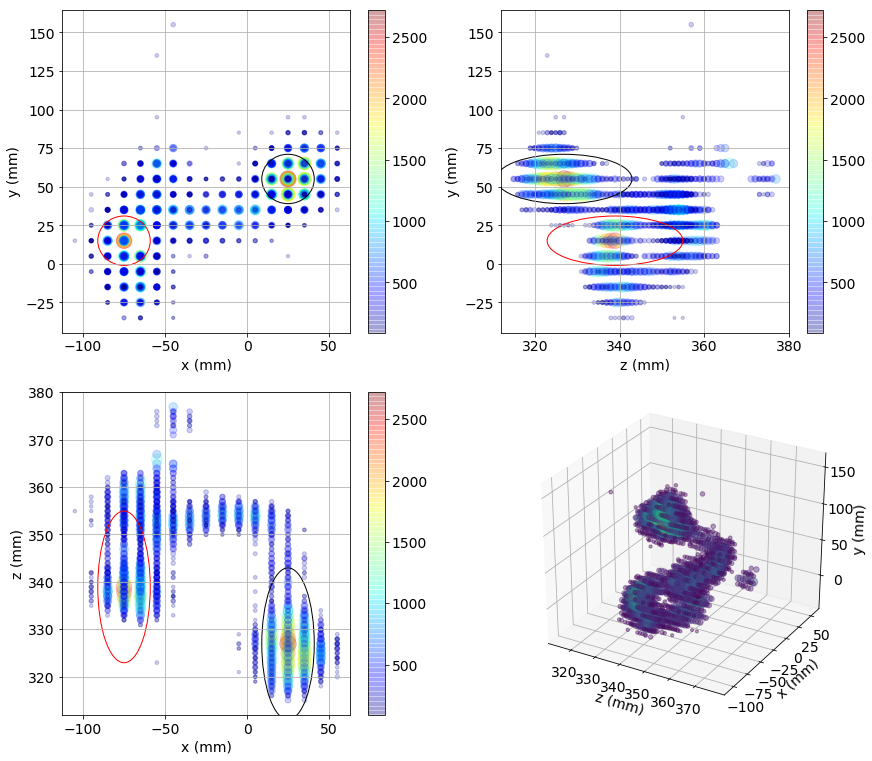

In [49]:
xsel = esel & (in_range(esum.zsize, 0, 80))
print(np.sum(xsel))
ana_events(esum, xsel, (0, 10))

## Tl-DS

In [60]:
mu, sig, nsig  = dsres.x[3], dsres.x[4], 0.25
print(mu, sig)

408106.57230438 3964.9890339735853


In [61]:
esel = in_range(esum.e, mu - nsig*sig, mu + nsig*sig)
print(np.sum(esel))

536


### DS long tracks

124
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0012_6341_trigger2_v0.9.9_20180921_krbg1300.h5


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0094_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0305_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0387_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0418_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0480_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0505_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0524_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigge

/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_1093_6341_trigger2_v0.9.9_20180921_krbg1300.h5


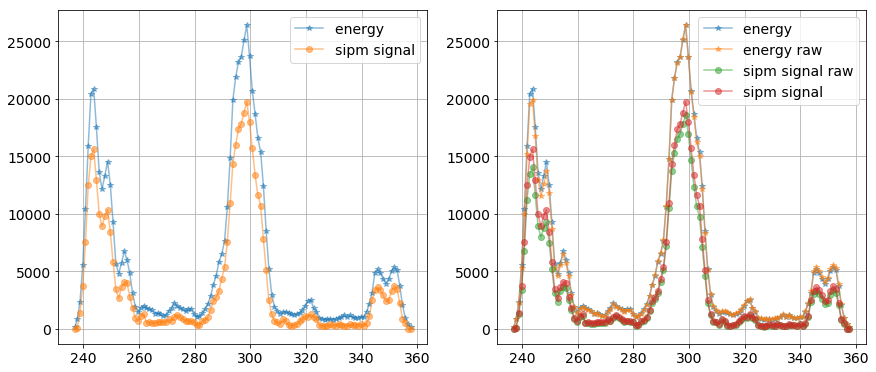

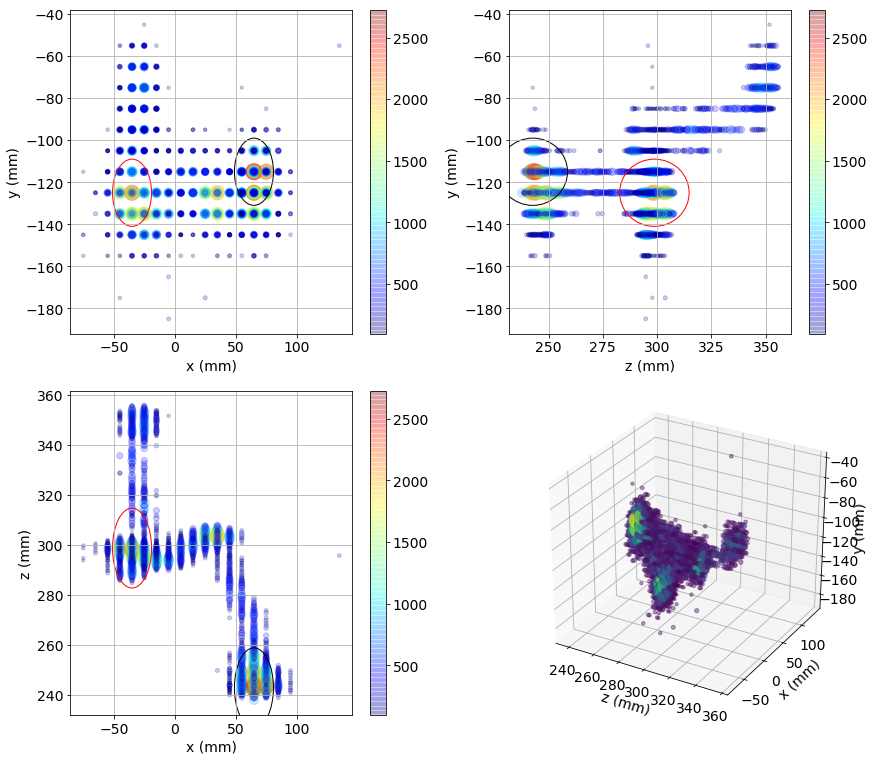

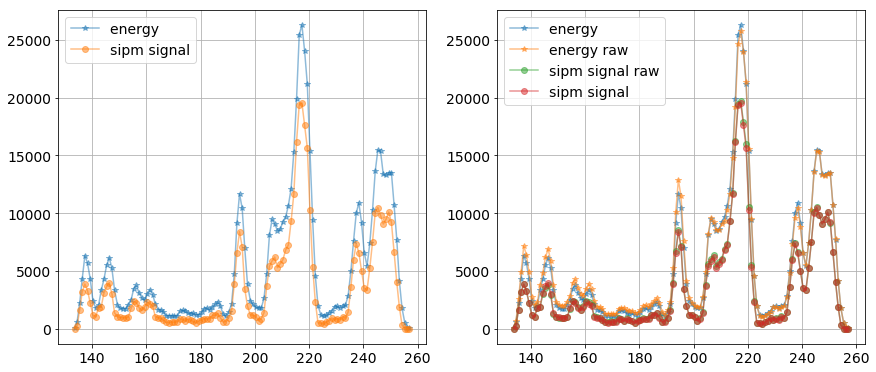

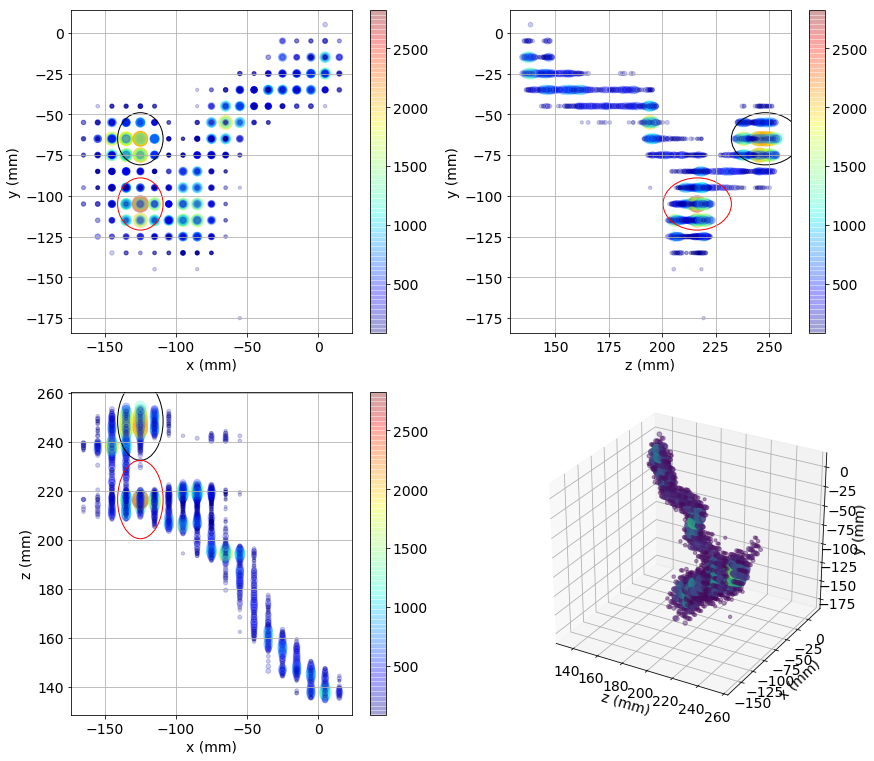

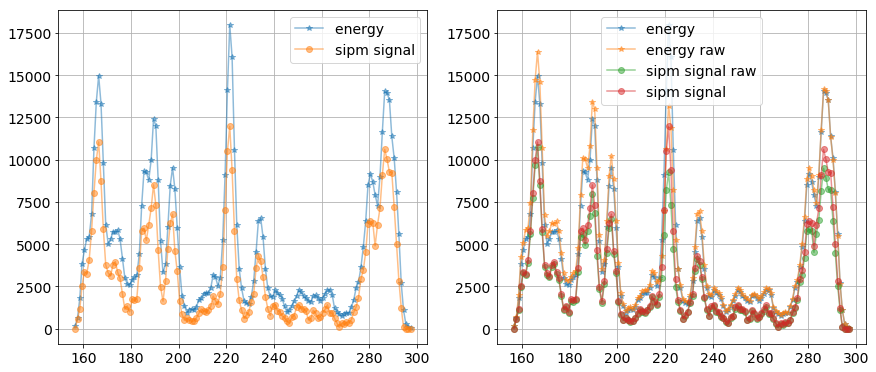

...

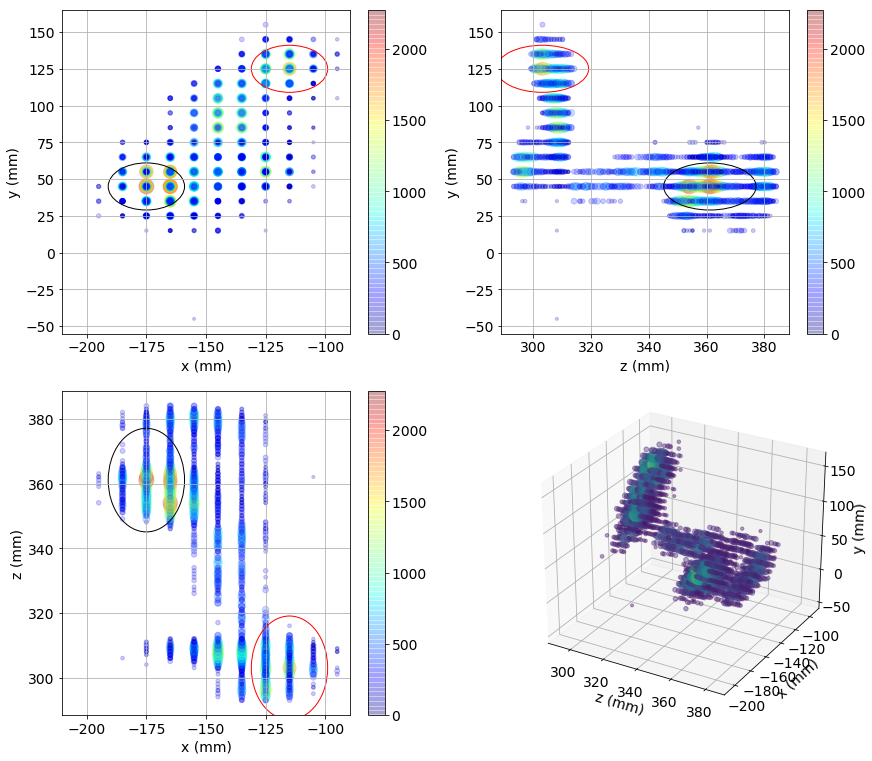

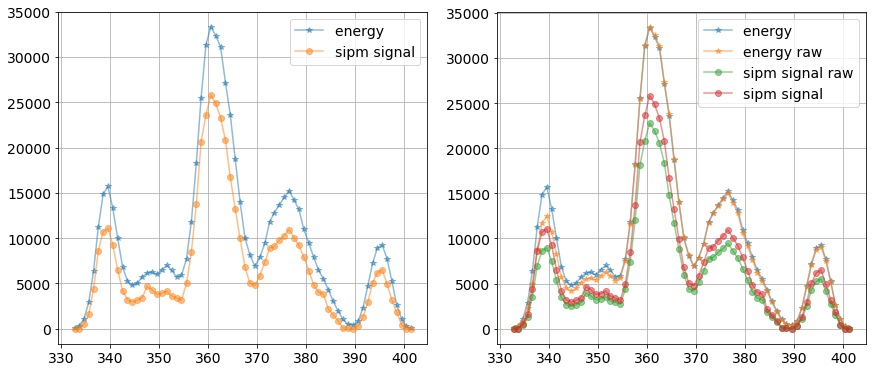

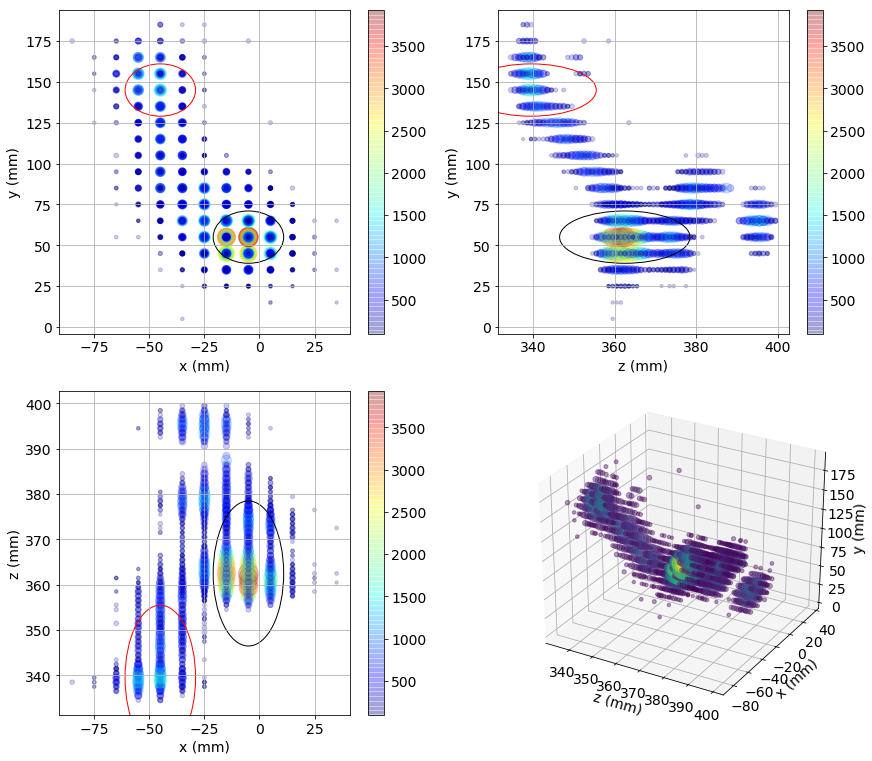

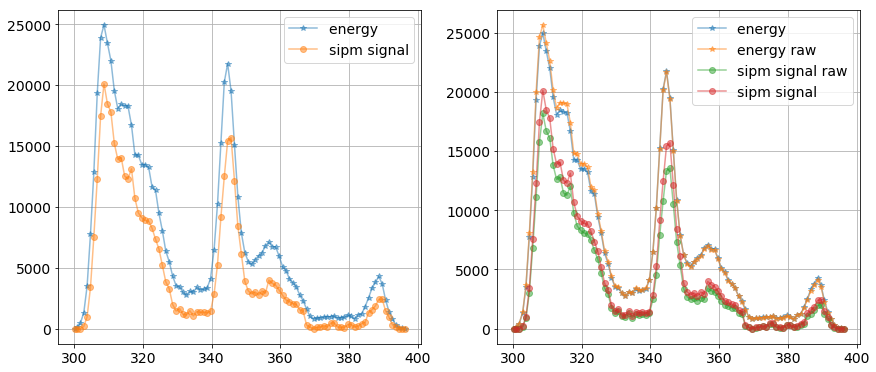

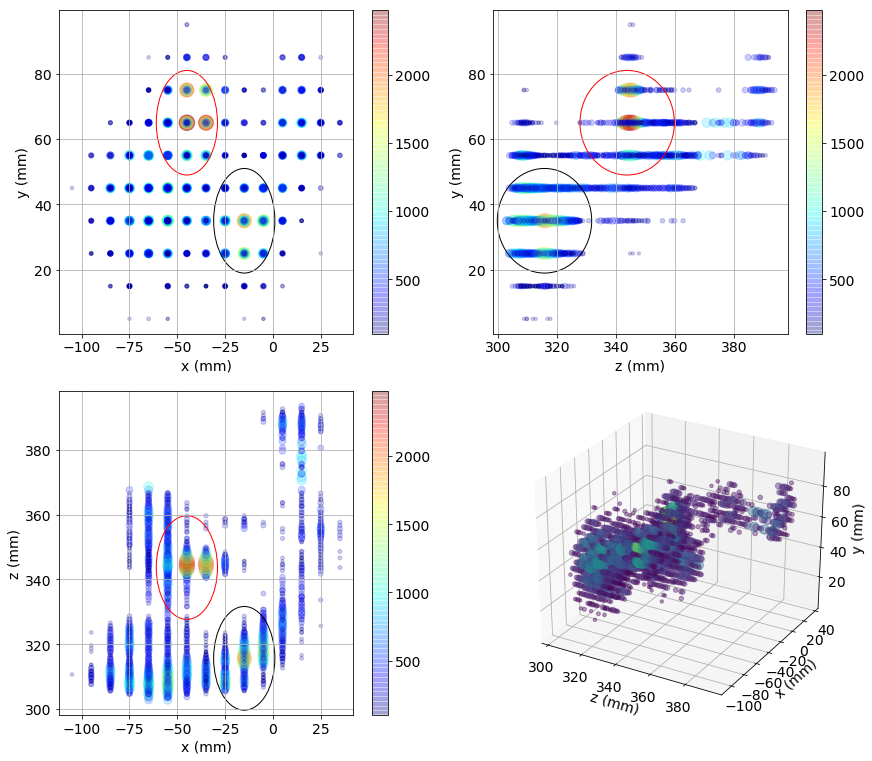

In [18]:
xsel = esel & (in_range(esum.zsize, 60, 150))
print(np.sum(xsel))
ana_events(esum, xsel, (0, 12))

### DS sort tracks

762
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0013_6341_trigger2_v0.9.9_20180921_krbg1300.h5


/Users/hernando/miniconda/envs/IC-3.6-2018-08-29/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0016_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0018_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0054_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0078_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0078_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0085_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigger2/pmaps_0090_6341_trigger2_v0.9.9_20180921_krbg1300.h5
processing  /Users/hernando/investigacion/NEXT/data/runIV//6341/pmaps/trigge

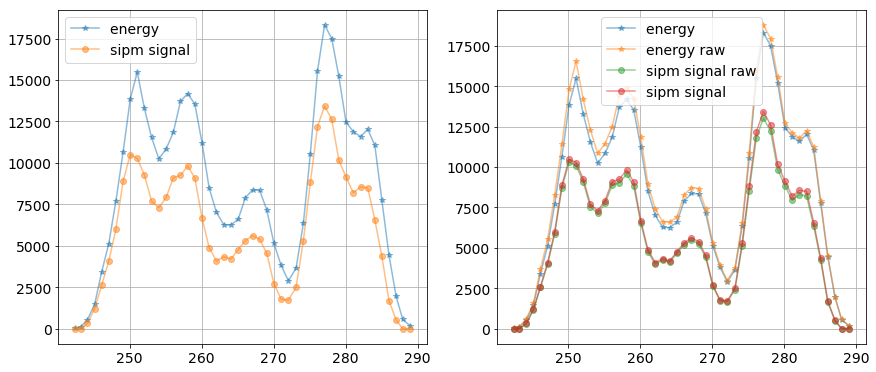

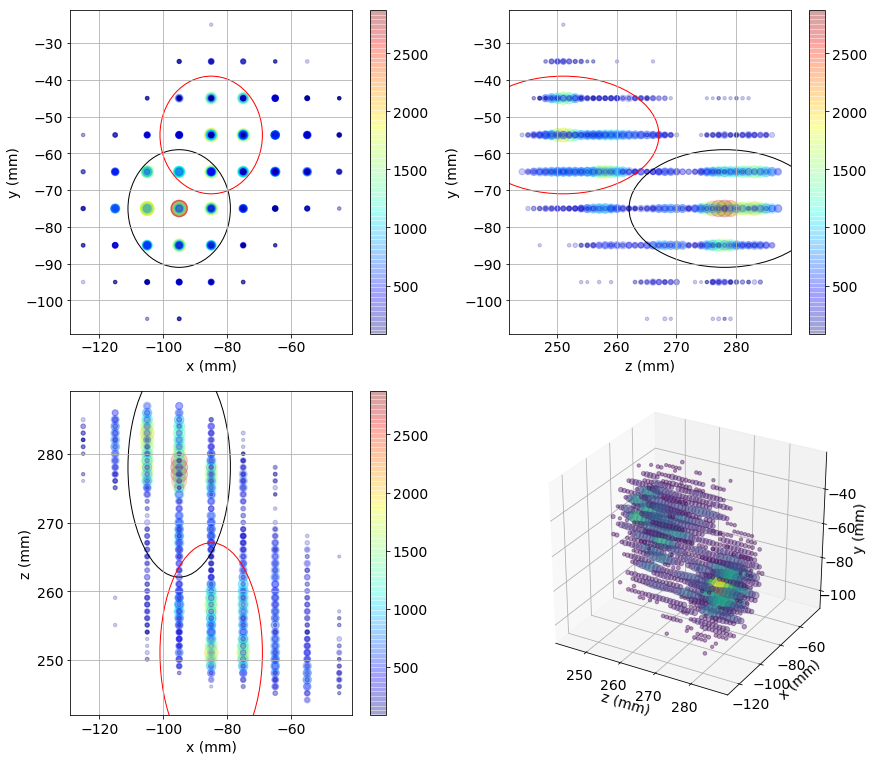

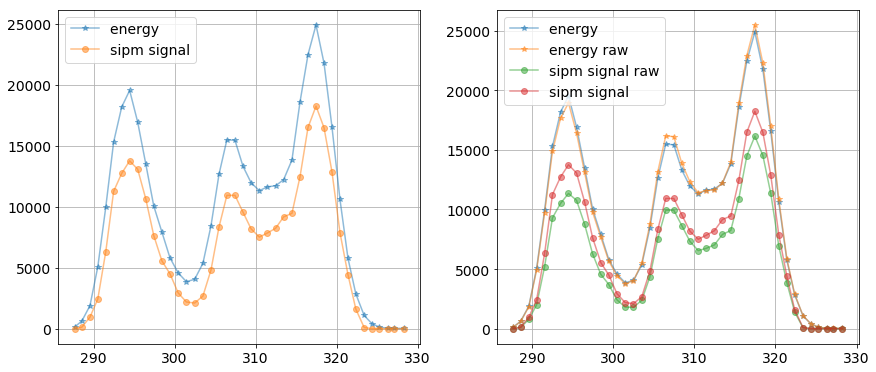

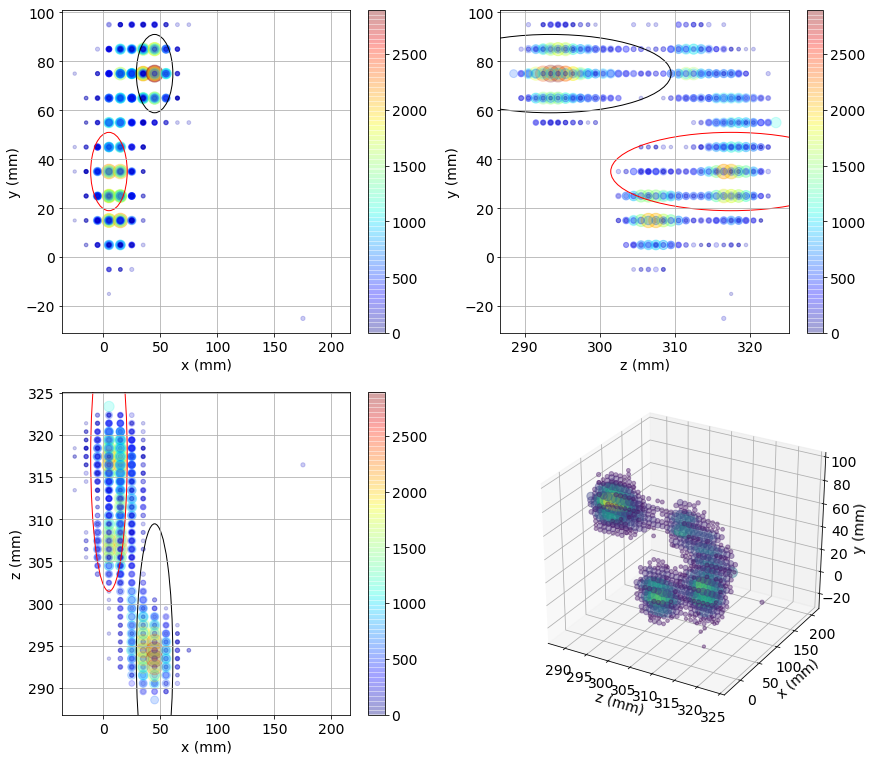

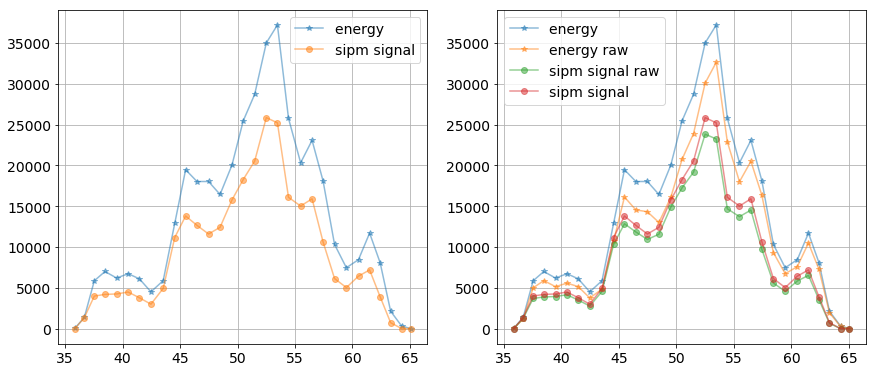

...

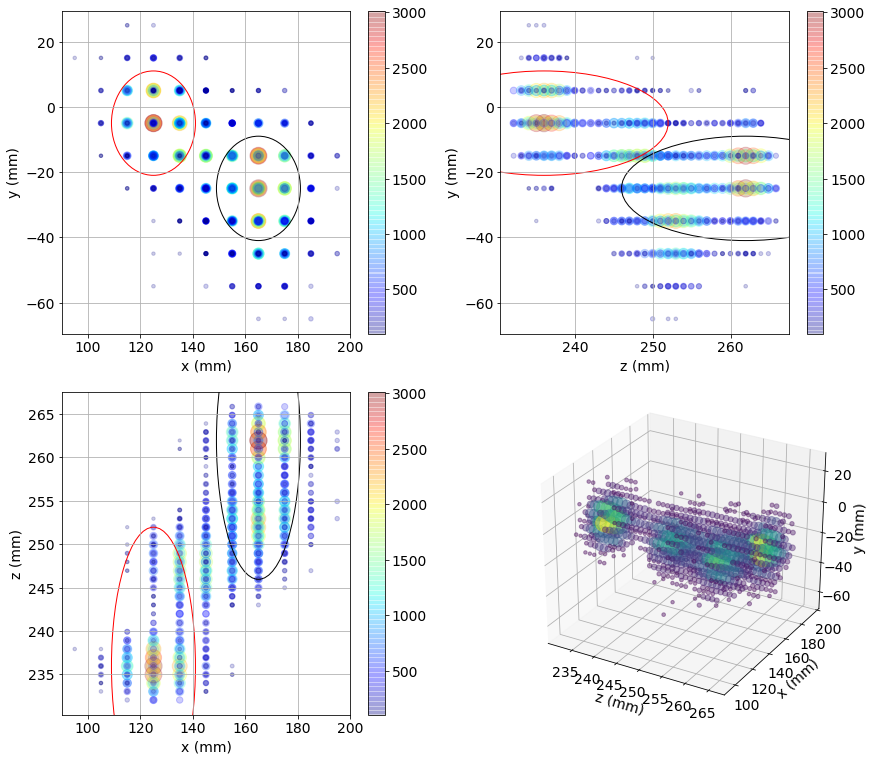

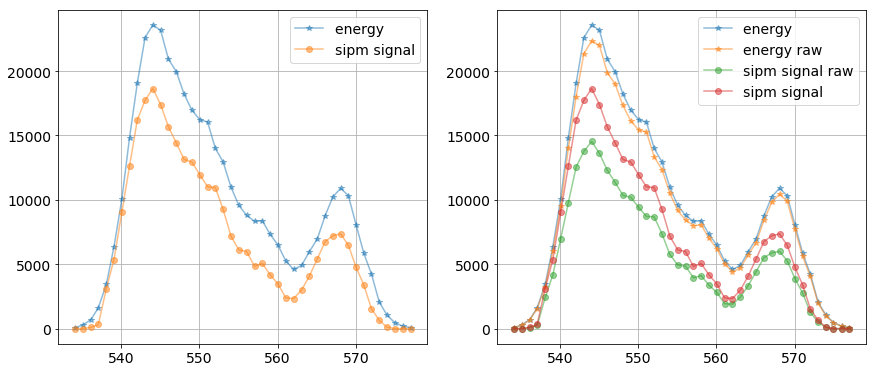

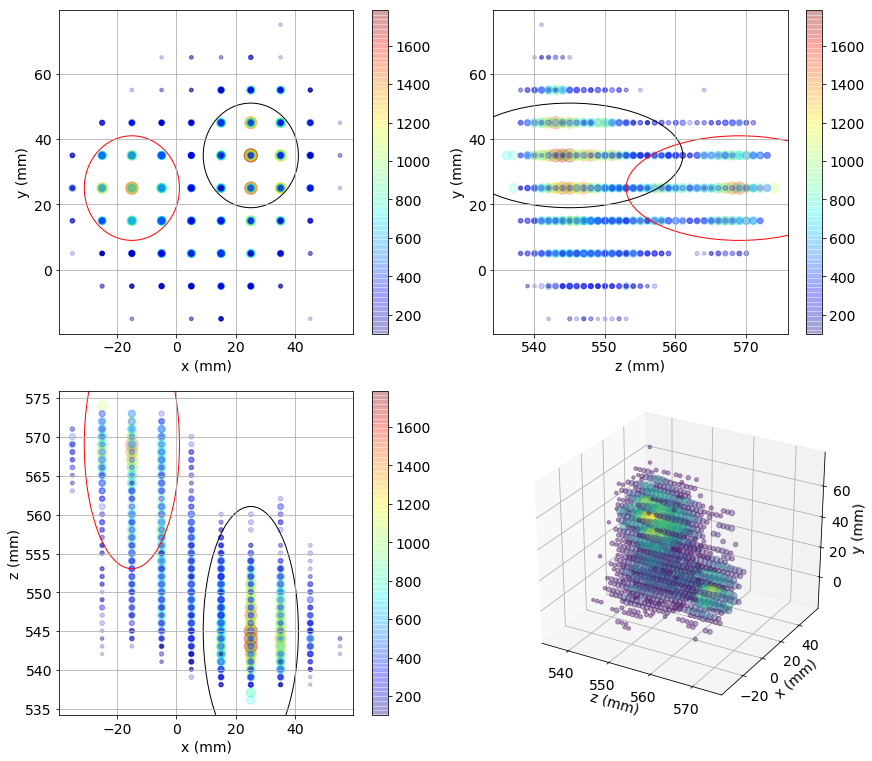

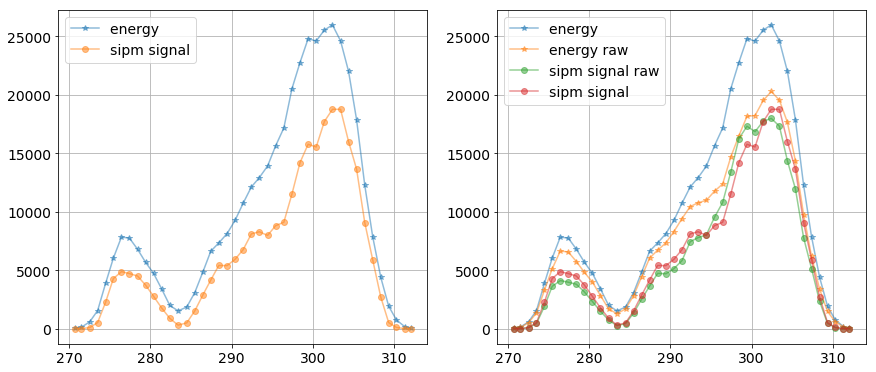

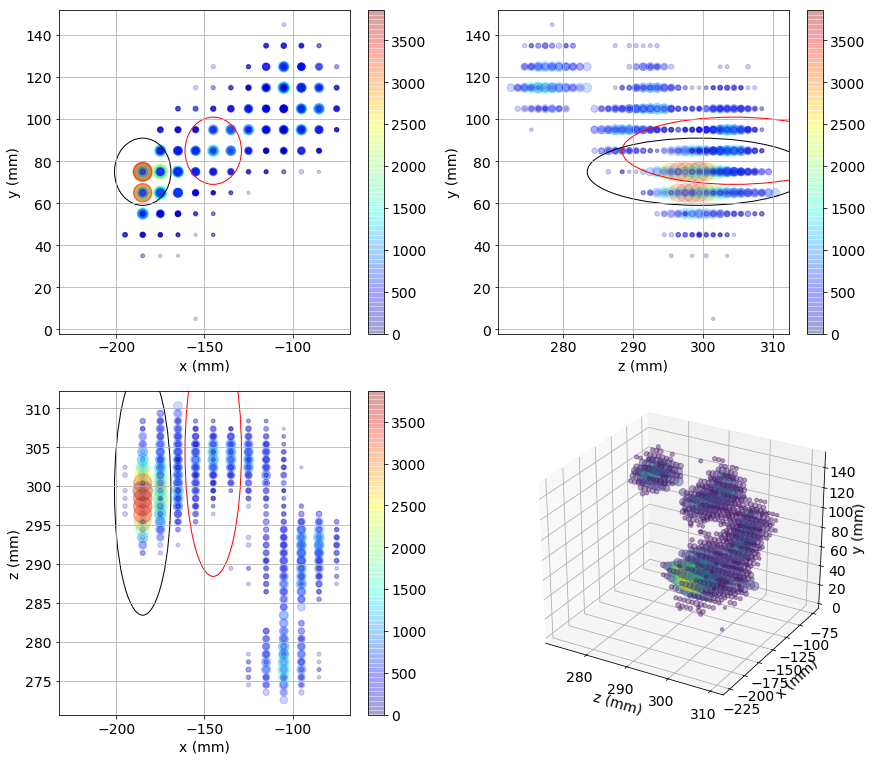

In [57]:
mu, sig, nsig  = tlres.x[3], tlres.x[4], 0.5
print(mu, sig)